# NCAA Score Prediction (Linear Regression)
## Tony Ghabour
***

# Motivation

In what follows we attempt to use OLS Linear Regression to predict the outcome of NCAA, Division I Men's basketball games.  

To do so we rely on numerous historical performance statistics for non-tournament games played at non-neutral sites for the 2016-2017 and 2017-2018 seasons obtained from: https://console.cloud.google.com/marketplace/details/ncaa-bb-public/ncaa-basketball. This data is further supplemented by average height and weight information for the relevant rosters obtained from https://www.sports-reference.com.  
  
**See "Data" notebook for more information regarding data collection.**

## Original Objective

The initial idea for this project involved developing a single model that would predict total points scored by the home team minus points scored by the guest. In practice, such a model would allow the user to predict the winner of the game and the margin of victory. 

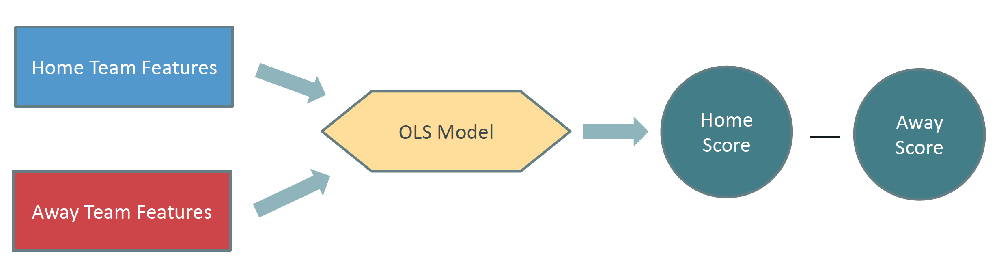

## Revised Objective

However, after additional consideration it was decided that developing two distinct models - one to predict the home score and another to predict the guest's score, was preferable since it allows us to predict: 
- the winner of the game,   
- the margin of victory, AND   
- the total score of the game. 

Furthermore, the revised approach may be preferable since it has the potential to more closely model the system it intends to simulate. To illustrate, consider two games with final scores of 75-69 and 176-170. Under the original design, these outcomes would appear equivalent/indistinguishable, since the away team wins by six points in both cases. Under the revised design, however, the models would presumably "understand" that the score in second game is absurd and never simulate such an outcome. 


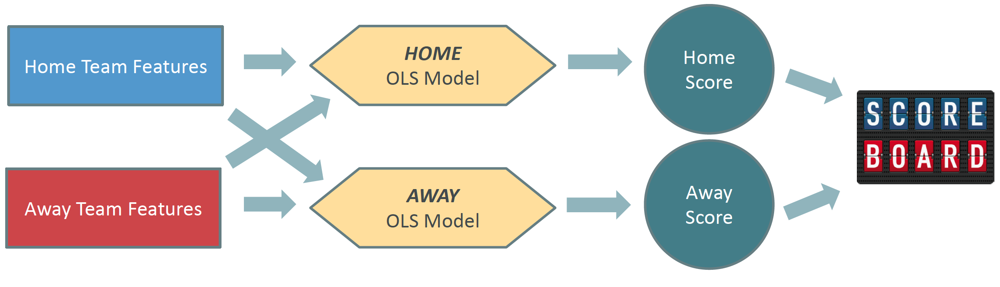

## Strategy and Methodology

Our strategy for this project involves taking a **"top-down"** approach whereby we:
 - collect numerous features,
 - use polynomial terms to artificially create additional features,
 - deliberately start with (what we hope will be) an overfitted baseline,
 - rely on regularization to emphasize relevant features and drop those that don't contribute to accurate predictions.

For these purposes, we're prioritizing the models' performance above all else. The hope is that our models will benefit from including as many potentially relevant features as possible and use that extra information to increase accuracy AND reliability. Consequently, we must forego certain benefits that come with simpler models - not least of which is interpretability.  

In [1]:
# Initial setup
import sys
sys.path.append('../src')

import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import NCAA_functions as ncaa

from itertools import islice
from sklearn.metrics import r2_score, mean_squared_error
from sklearn.linear_model import LinearRegression, Lasso, Ridge
from sklearn.preprocessing import StandardScaler, PolynomialFeatures
from sklearn.model_selection import train_test_split, KFold

# Retreive and Prepare Data for Modeling

**Retrieve pre-processed data for modeling.**

In [2]:
model_data = ncaa.get_model_data()

/opt/anaconda3/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3331: DtypeWarning: Columns (1,3,7,8,9) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


**High-level inspection to confirm data coming in as expected.**

In [3]:
model_data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 9301 entries, 0 to 9300
Data columns (total 50 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   game_id                      9301 non-null   object 
 1   scheduled_date               9301 non-null   object 
 2   lead_changes_home            9301 non-null   float64
 3   periods_home                 9301 non-null   float64
 4   alias_home                   9301 non-null   object 
 5   ppg_home                     9301 non-null   float64
 6   field_goals_att_home         9301 non-null   float64
 7   three_points_att_home        9301 non-null   float64
 8   three_points_pct_home        9301 non-null   float64
 9   two_points_att_home          9301 non-null   float64
 10  two_points_pct_home          9301 non-null   float64
 11  blocked_att_home             9301 non-null   float64
 12  free_throws_att_home         9301 non-null   float64
 13  free_throws_pct_ho

In [4]:
model_data.head()

,game_id,scheduled_date,lead_changes_home,periods_home,alias_home,ppg_home,field_goals_att_home,three_points_att_home,three_points_pct_home,two_points_att_home,...,steals_away,blocks_away,assists_turnover_ratio_away,personal_fouls_away,foulouts_away,fast_break_pts_away,second_chance_pts_away,team_turnovers_away,points_off_turnovers_away,team_rebounds_away
0,5d5ede6e-f426-40a1-9b5c-2a071e6aafa7,2016-11-13 00:00:00,1.0,2.0,BRWN,55.0,57.0,25.0,40.000000,32.0,...,10.0,2.0,0.312500,19.0,0.0,0.0,7.0,0.0,12.0,7.0
1,70ac69f2-3627-45fd-8e59-dab0483b98af,2016-11-13 00:00:00,3.0,2.0,ORST,78.0,46.0,16.0,18.750000,30.0,...,4.0,0.0,0.550000,24.0,0.0,2.0,25.0,0.0,6.0,3.0
2,2f38391c-c6b9-4290-b39b-94cc3281ff9f,2016-11-13 00:00:00,0.0,2.0,WAKE,80.0,65.0,18.0,27.777778,47.0,...,14.0,6.0,1.200000,20.0,0.0,6.0,5.0,0.0,22.0,2.0
3,8036ad31-0cc5-4834-887f-6cc87c1124f3,2016-11-13 00:00:00,1.0,2.0,PSU,81.0,63.0,25.0,36.000000,38.0,...,6.0,12.0,0.600000,2.0,0.0,9.0,8.0,1.0,14.0,8.0
4,ae4933bf-0be0-4b14-a1d7-a6dac4927f22,2016-11-13 00:00:00,0.0,2.0,UNC,95.0,69.0,20.0,45.000000,49.0,...,9.0,3.0,0.857143,26.0,0.0,4.0,13.0,0.0,18.0,5.0


**Import response variable values (points scored) to fit/predict.**

In [5]:
raw_game_data = ncaa.get_game_data() #.reset_index()
y = raw_game_data[['game_id', 'h_points', 'a_points']]
y.head()

/opt/anaconda3/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3254: DtypeWarning: Columns (4,7,16,21) have mixed types.Specify dtype option on import or set low_memory=False.
  if (await self.run_code(code, result,  async_=asy)):


,game_id,h_points,a_points
6469,8c8d2a48-2335-4acd-8304-8658b7c4f193,79.0,77.0
6470,0910b42c-d65f-44da-8076-f1bfcf2b3399,84.0,53.0
6471,b0cf1cc3-85c3-4a81-84a9-5c45624e0dfa,78.0,76.0
6472,4eb7e921-ecf2-4c3c-af68-590d44b9c717,75.0,67.0
6473,9fd12195-25c0-4a97-8ea9-c2308b538d6b,72.0,83.0


**Merge total points data with feature variables**

In [6]:
model_data = model_data.merge(y, left_on='game_id', right_on='game_id', suffixes=(False, False))
model_data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 9301 entries, 0 to 9300
Data columns (total 52 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   game_id                      9301 non-null   object 
 1   scheduled_date               9301 non-null   object 
 2   lead_changes_home            9301 non-null   float64
 3   periods_home                 9301 non-null   float64
 4   alias_home                   9301 non-null   object 
 5   ppg_home                     9301 non-null   float64
 6   field_goals_att_home         9301 non-null   float64
 7   three_points_att_home        9301 non-null   float64
 8   three_points_pct_home        9301 non-null   float64
 9   two_points_att_home          9301 non-null   float64
 10  two_points_pct_home          9301 non-null   float64
 11  blocked_att_home             9301 non-null   float64
 12  free_throws_att_home         9301 non-null   float64
 13  free_throws_pct_ho

**Eliminate top and bottom 1% of total points scored in a game (outliers).**

In [7]:
model_data = (model_data[(model_data.h_points < model_data.h_points.quantile(.99)) & 
                         (model_data.a_points < model_data.a_points.quantile(.99)) & 
                         (model_data.h_points > model_data.h_points.quantile(.01)) & 
                         (model_data.a_points > model_data.a_points.quantile(.01))])

**Evaluate distributions and relationships among variables considered.**  

As previously stated, our primary objective is to develop a relatively "accurate" model in lieu of gaining understanding about the underlying mechanisms involved in scoring. To this end, we forego interpretability of the resulting coefficients and allow for somewhat significant multicollinearity among the feature variables. 

Nevertheless, let's investigate the degree to which multicollinearity exists in the data and confirm perfect multicollinearity is avoided so that our models will converge when training. 

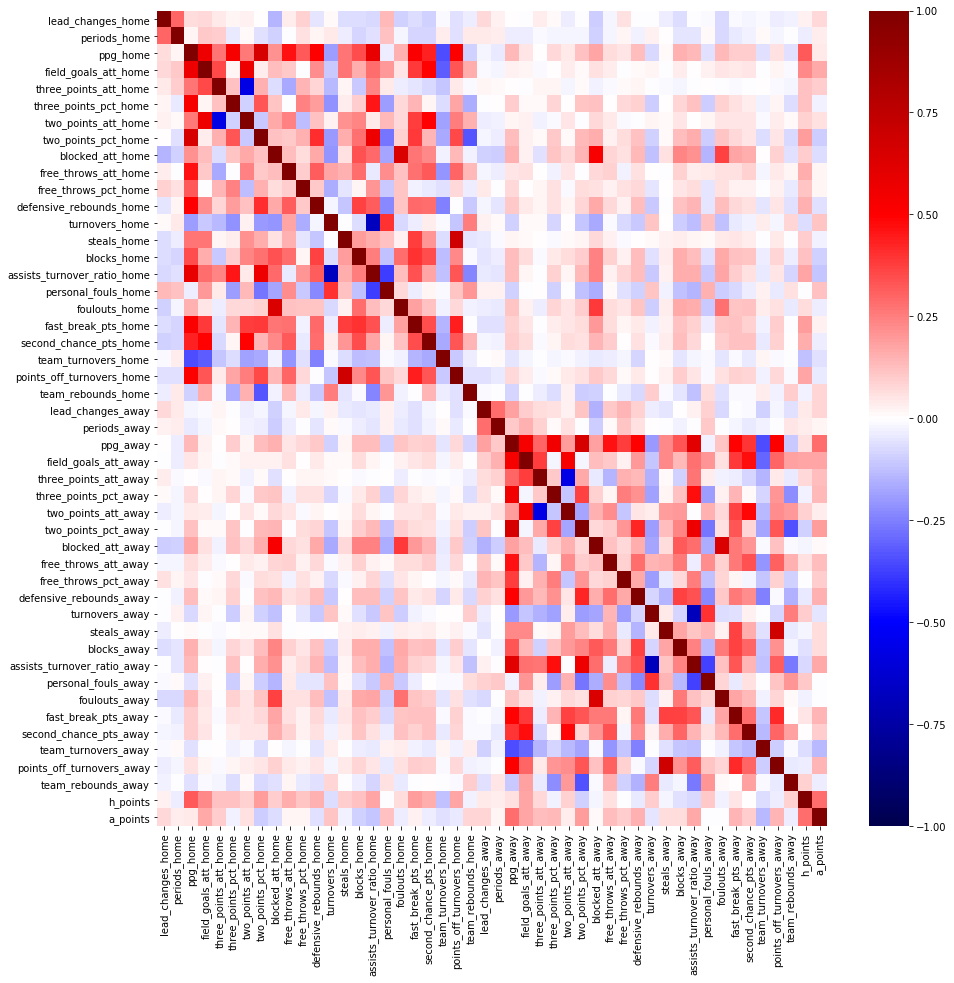

In [8]:
plt.figure(figsize=(15, 15))
sns.heatmap(model_data.corr(), cmap="seismic", annot=False, vmin=-1, vmax=1);

In [9]:
# Split variables (48 input features and 2 response variables) into groups to be used in pair plots 

cols = model_data.corr().columns.to_list()
lengths = [10] * 5
iter_cols = iter(cols)
col_split = [list(islice(iter_cols, length)) for length in lengths] 

In [10]:
pair_df = model_data.drop(columns = ['game_id','scheduled_date', 'alias_home', 'alias_away'])

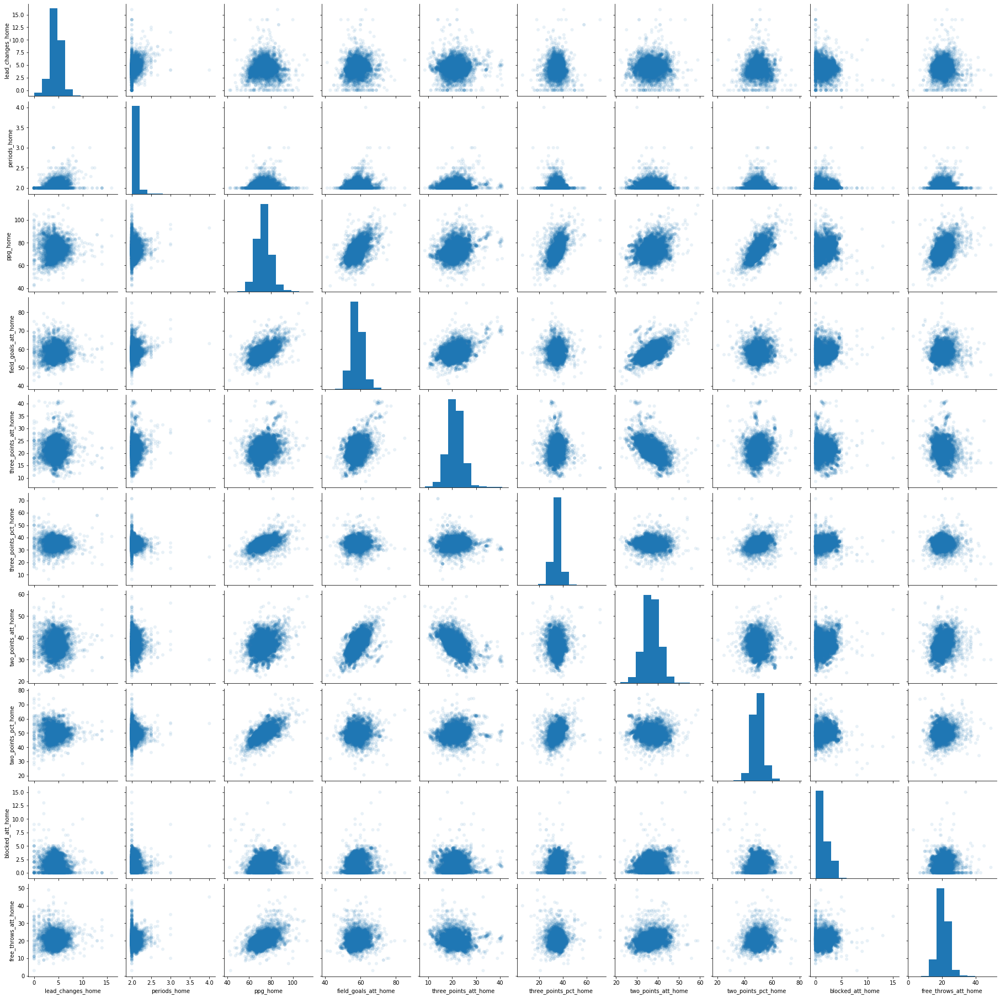

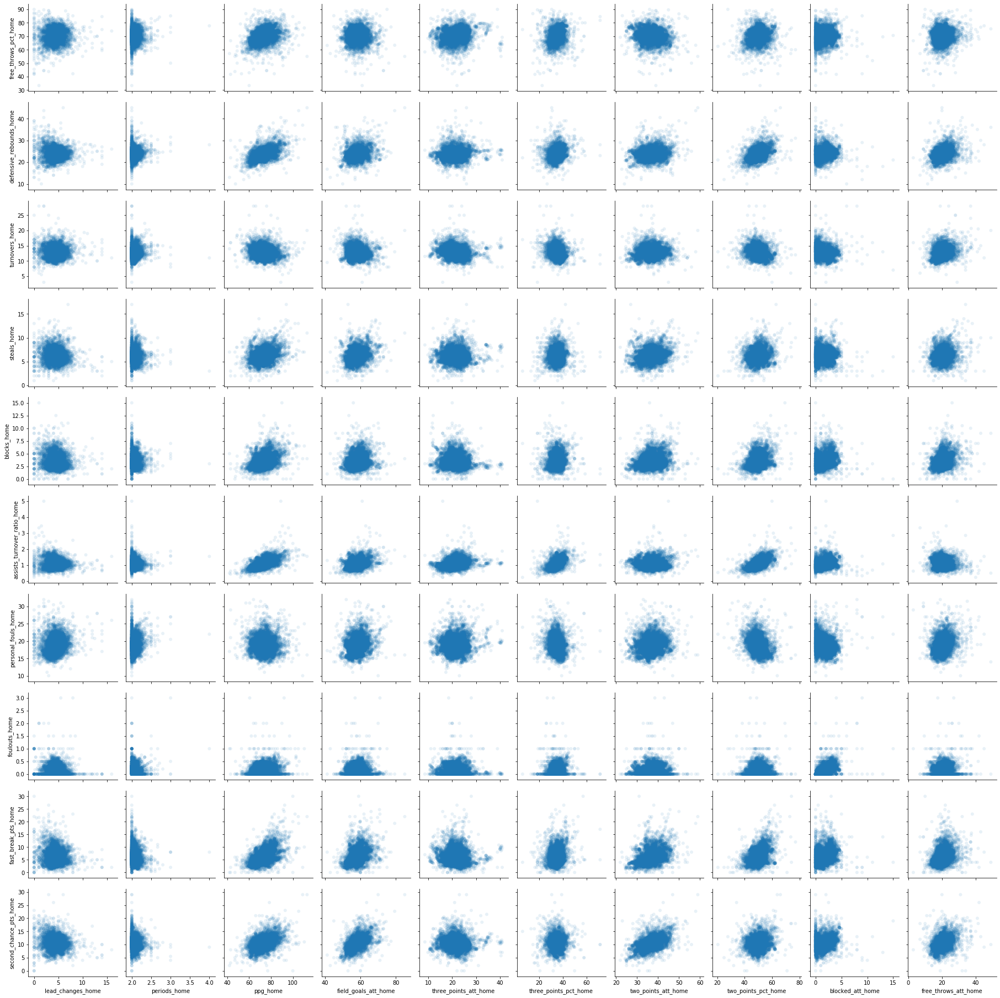

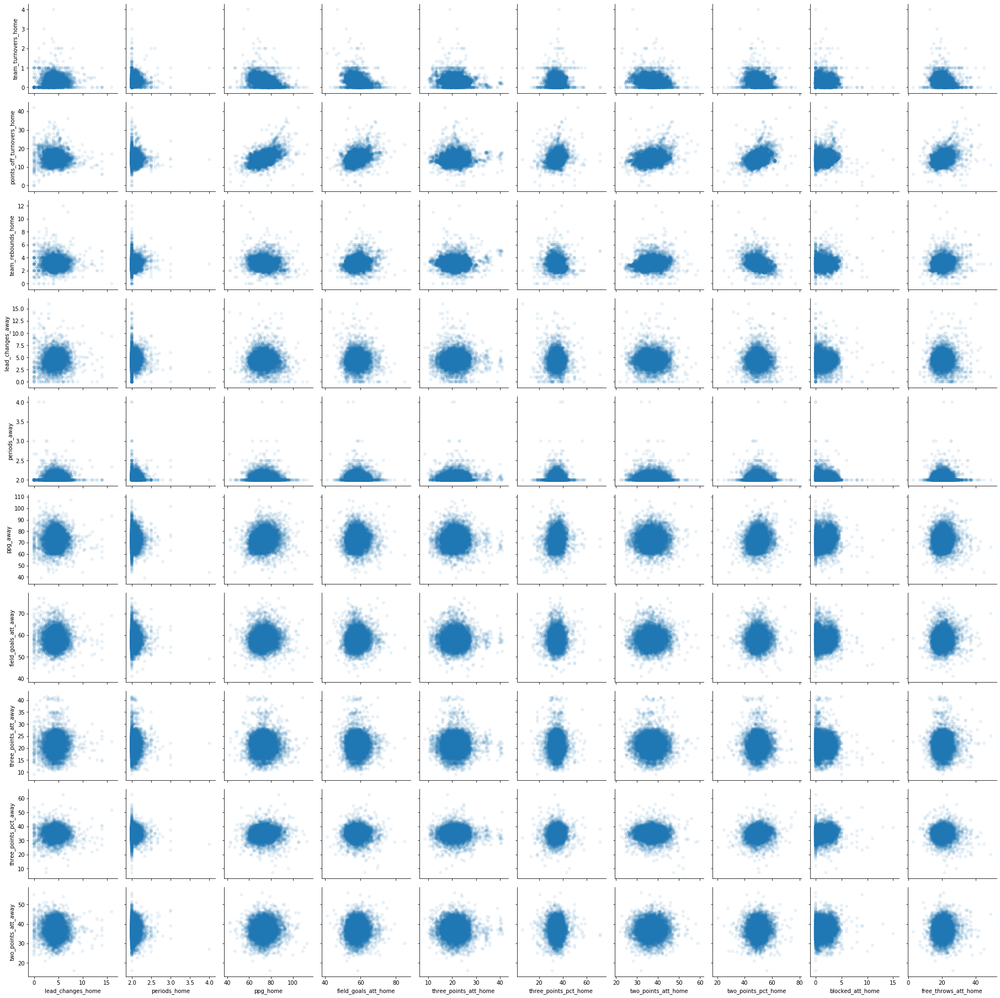

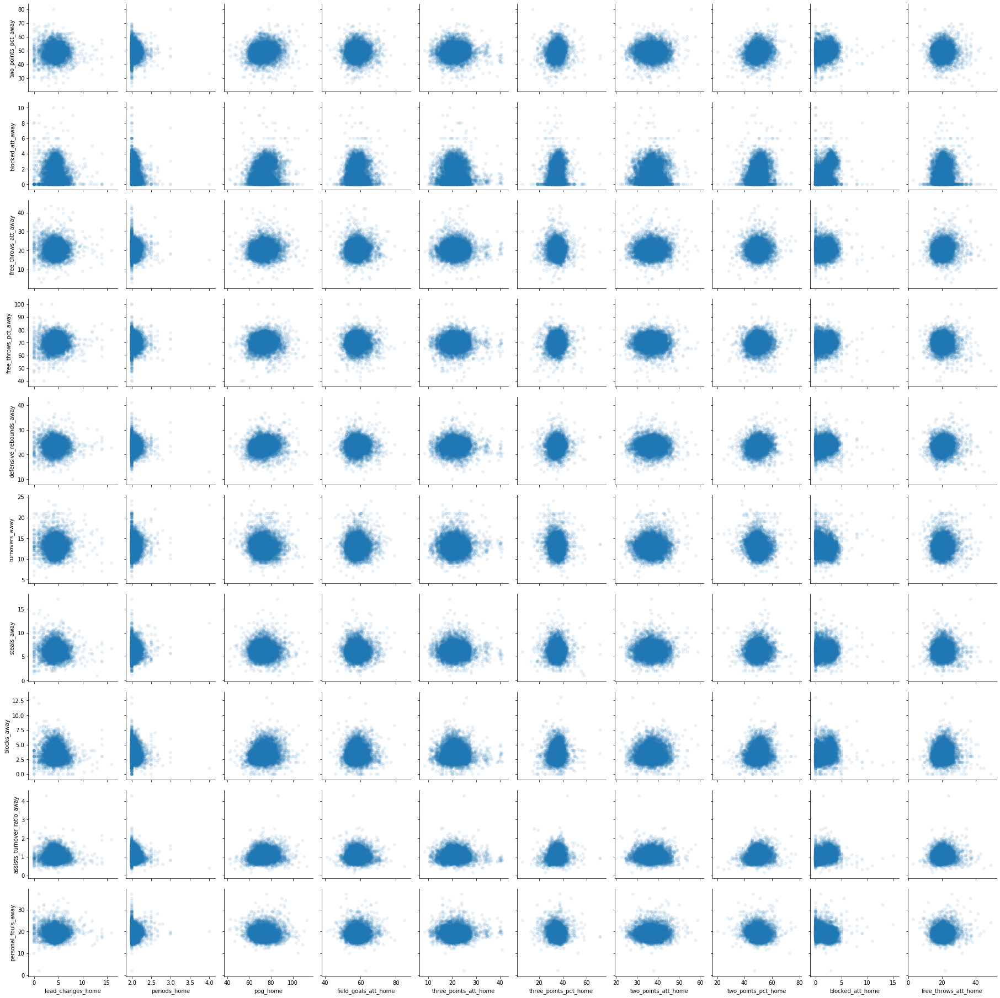

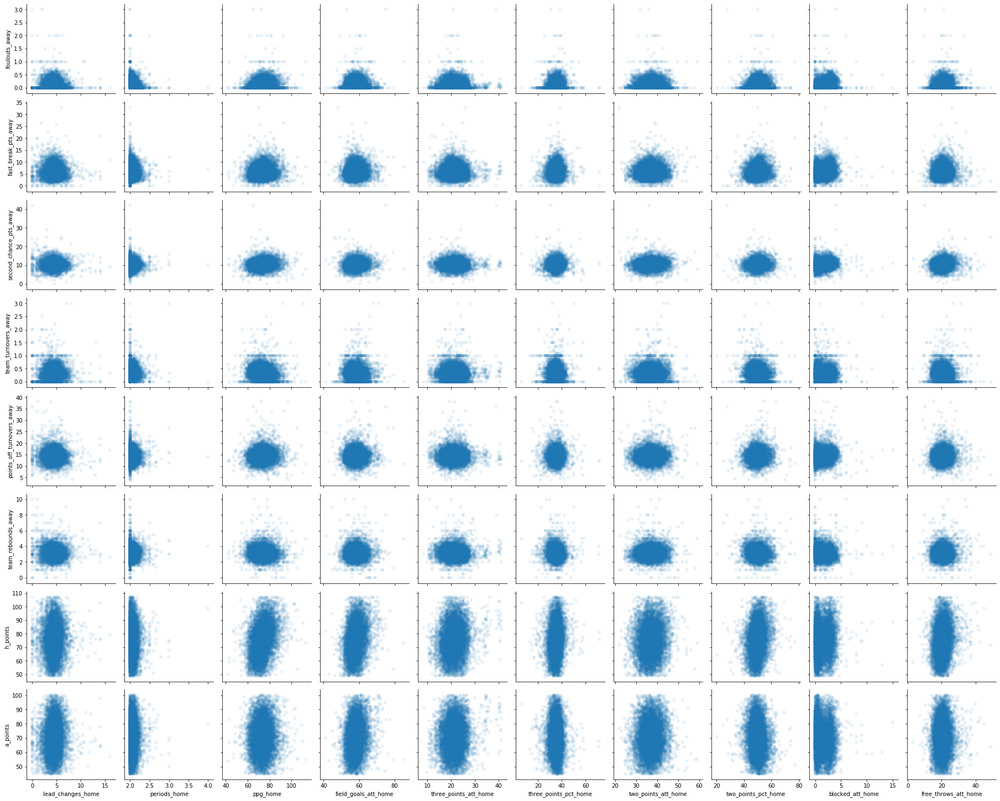

...

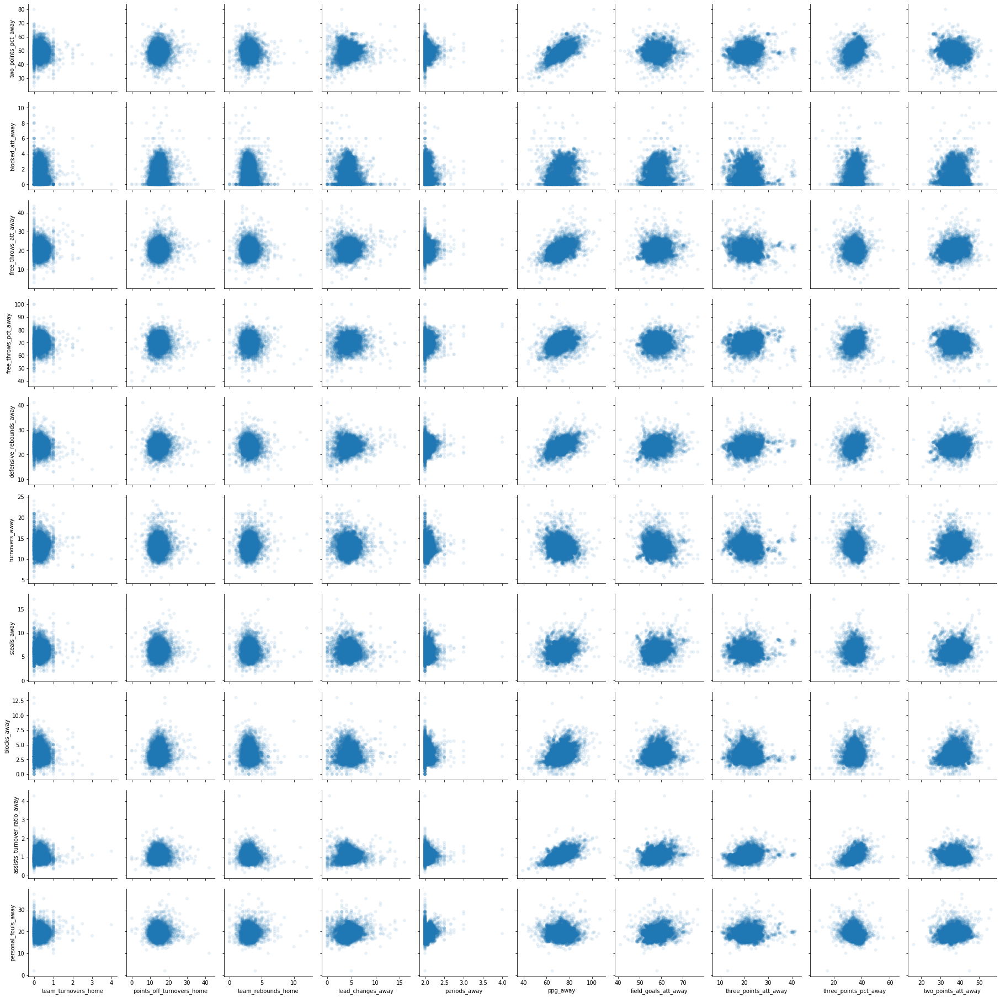

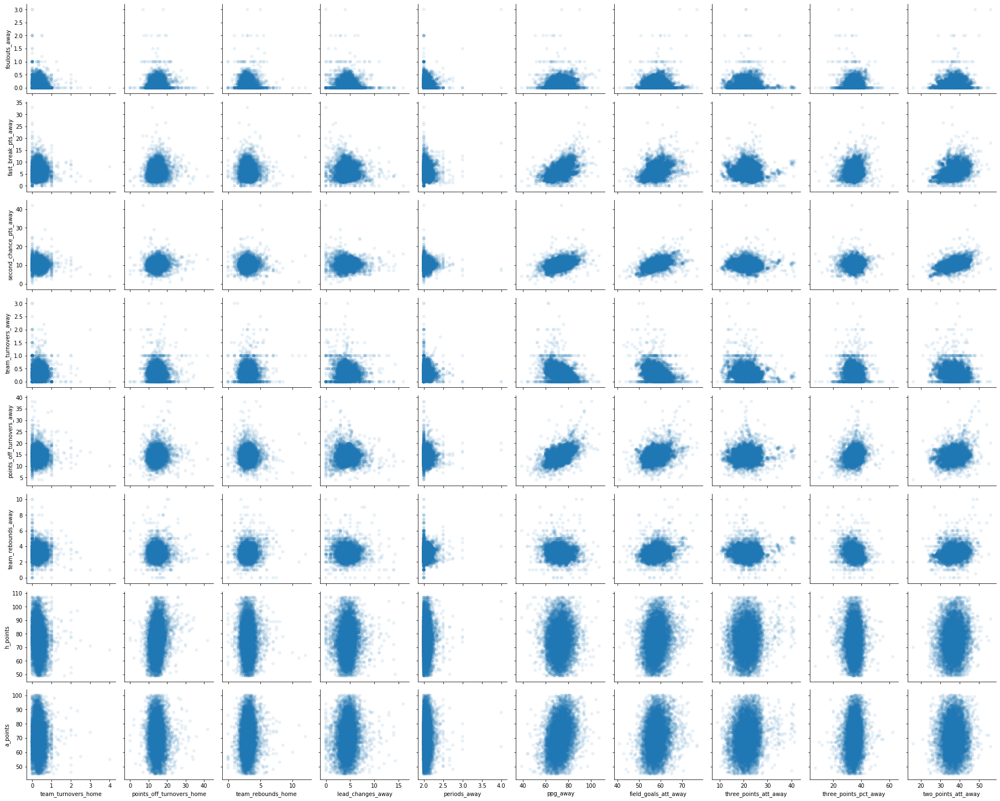

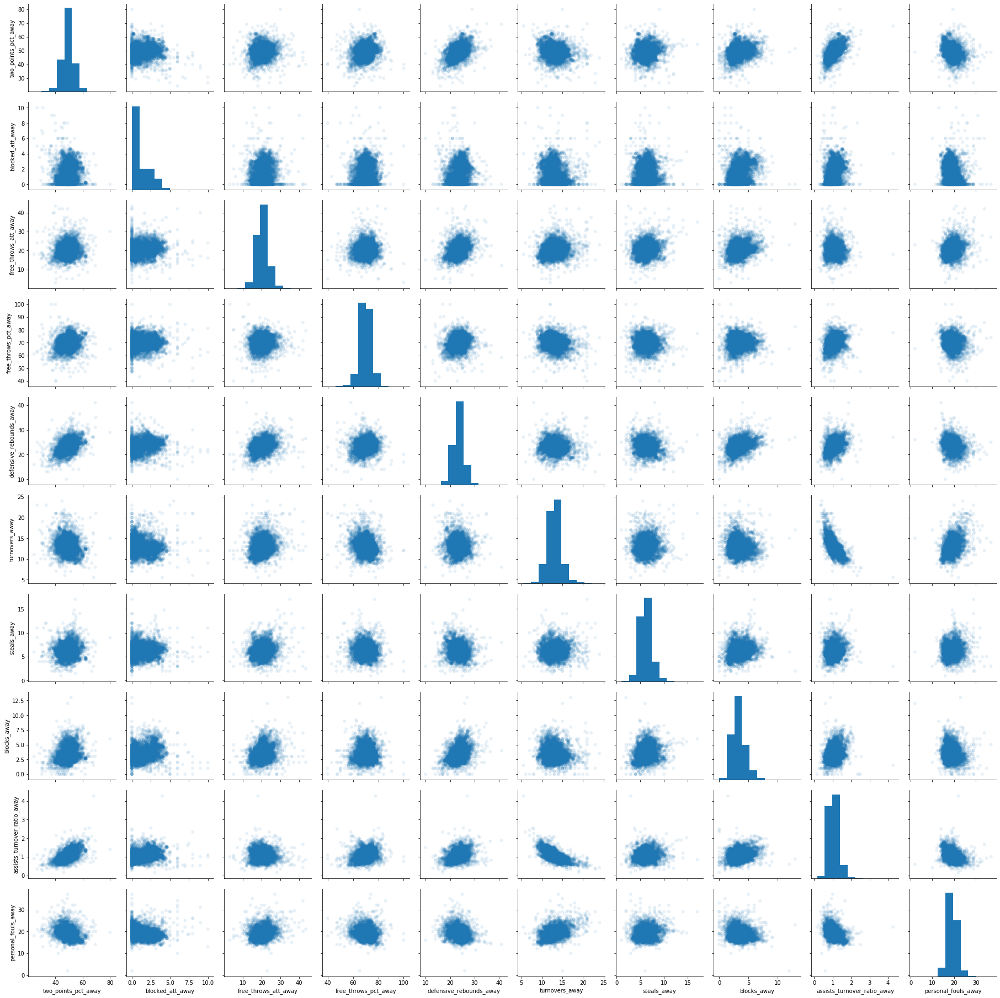

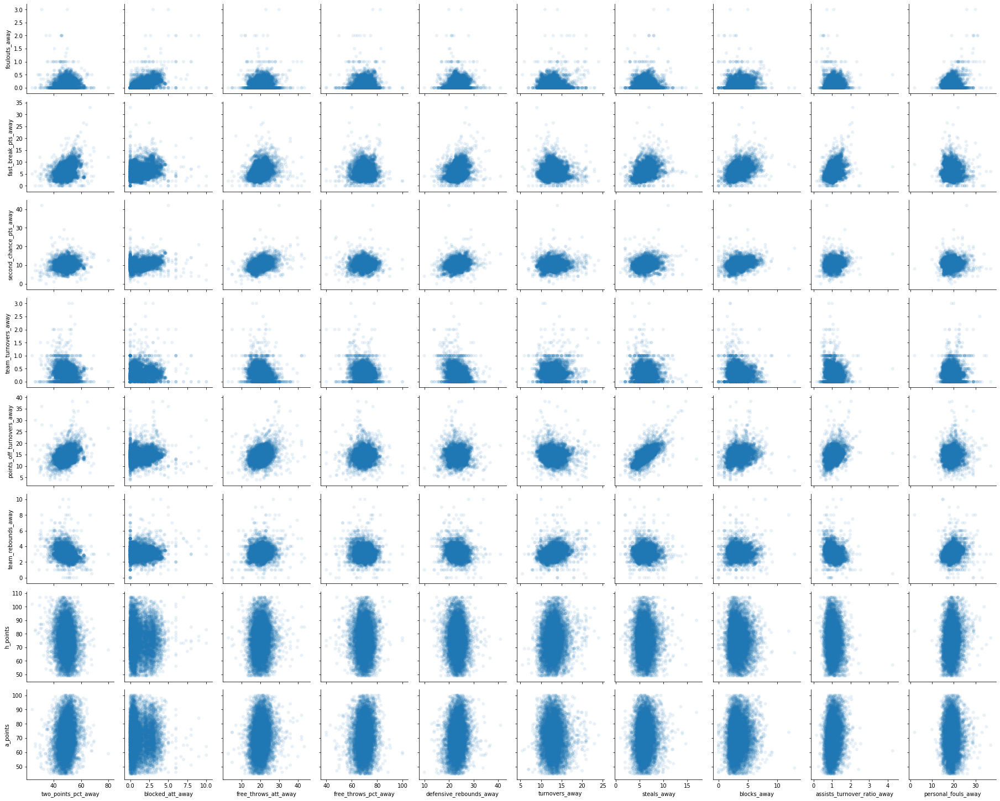

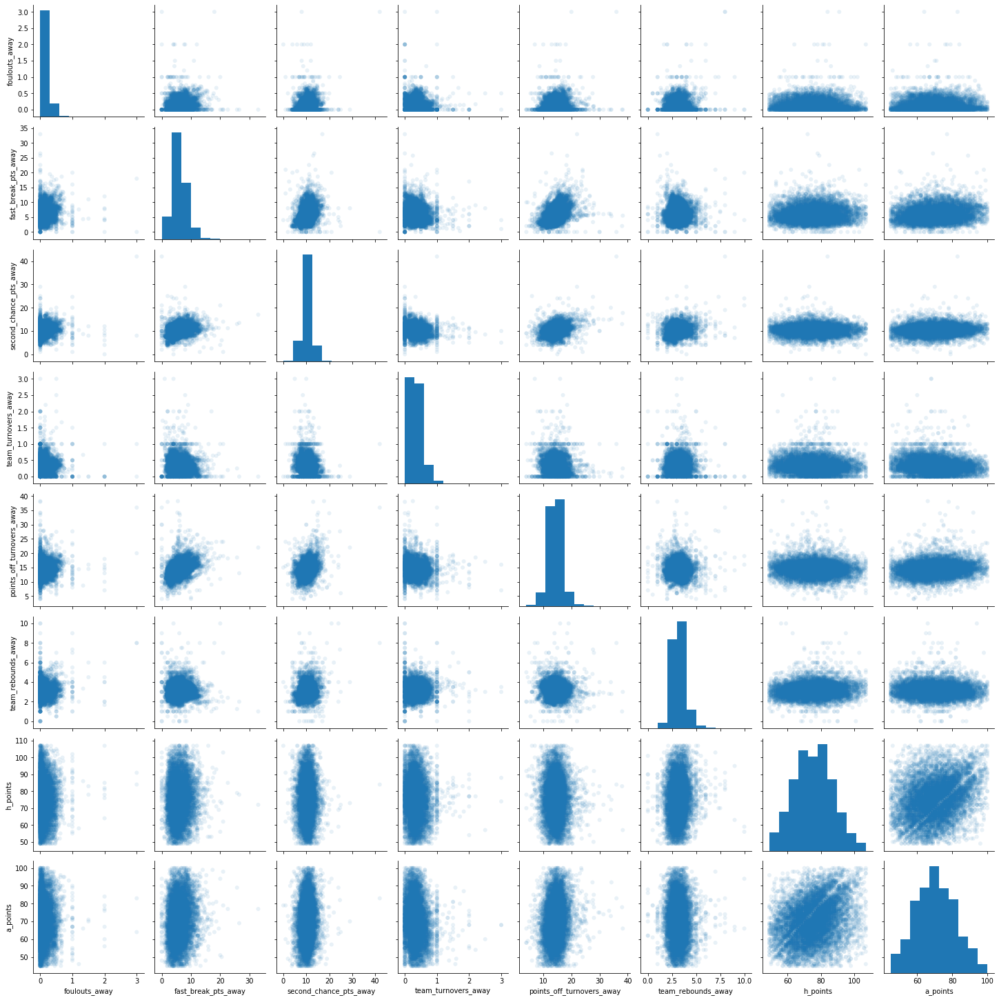

In [11]:
for i in range(5):
    for j in range(5):
        if i <= j:
            sns.pairplot(pair_df, plot_kws=dict(alpha=.1, edgecolor='none'),  x_vars= col_split[i], y_vars=col_split[j]);

**Observations:**  
- The heat map of correlations includes a few "hot spots" suggesting we have some non-trivial multicollinearity amoung our features. However, since the emphasis is on performance we can proceed, understanding that our models will lack interpretability and that explanatory power may be distributed accross multiple coefficients. 


- Generally speaking, the pair plots don't show any exceedingly strong linear or otherwise well-defined mathematical relationships that might suggest dropping features or applying transformations.


**Create feature and response variable arrays for modeling.**

In [12]:
X = model_data.drop(columns = ['game_id',
                               'scheduled_date', 
                               'alias_home', 
                               'alias_away', 
                               'h_points', 
                               'a_points'])

y = pd.DataFrame()

y['home'] = model_data.h_points 
y['away'] = model_data.a_points

y.describe()

,home,away
count,8914.000000,8914.000000
mean,75.473861,70.247139
std,11.408908,11.240886
min,49.000000,45.000000
25%,67.000000,62.000000
50%,75.000000,70.000000
75%,83.000000,78.000000
max,107.000000,100.000000


**Set aside 20% "holdout" test set for final model evaluation.**

In [13]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=.2, random_state=420)

**Split remaining 80% into training and validation sets for model selection and hyperparamter tuning.**

In [14]:
X_tr, X_vl, y_tr, y_vl = train_test_split(X_train, y_train, test_size=.25, random_state=100)

# Linear Regression Modeling

## HOME Team Models

**Set up and fit HOME models under consideration.**

In [15]:
h_data = X_tr, X_vl, X_test, y_tr.home, y_vl.home, y_test.home 

lm_base  = ncaa.run_lm(h_data, deg = 1, int_only_ = False, reg = None,    alpha_ = None, id_ = 'Baseline')
lm_lasso = ncaa.run_lm(h_data, deg = 1, int_only_ = False, reg = 'Lasso', alpha_ = 1,    id_ = 'Lasso')
lm_ridge = ncaa.run_lm(h_data, deg = 1, int_only_ = False, reg = 'Ridge', alpha_ = 1,    id_ = 'Ridge')

# Working with MANY features, so prudent to employ regularization when working with polynomial models of degree > 1
lm_poly1 = ncaa.run_lm(h_data, deg = 2, int_only_ = True,  reg = 'Lasso', alpha_ = 1,    id_ = 'Poly1')
lm_poly2 = ncaa.run_lm(h_data, deg = 2, int_only_ = False, reg = 'Lasso', alpha_ = 1,    id_ = 'Poly2')

lm_poly3 = ncaa.run_lm(h_data, deg = 3, int_only_ = True,  reg = 'Lasso', alpha_ = 1,    id_ = 'Poly3')
lm_poly4 = ncaa.run_lm(h_data, deg = 3, int_only_ = False, reg = 'Lasso', alpha_ = 1,    id_ = 'Poly4')

Baseline: Degree = 1 (interaction_only = False), Regularization = None (alpha = None)
  * Training R^2:    0.22370
  * Validation R^2:  0.23210
  * Training RMSE:   9.99684
  * Validation RMSE: 9.97403

Lasso: Degree = 1 (interaction_only = False), Regularization = Lasso (alpha = 1)
  * Training R^2:    0.12771
  * Validation R^2:  0.13286
  * Training RMSE:   10.59690
  * Validation RMSE: 10.59896

Ridge: Degree = 1 (interaction_only = False), Regularization = Ridge (alpha = 1)
  * Training R^2:    0.22412
  * Validation R^2:  0.23277
  * Training RMSE:   9.99415
  * Validation RMSE: 9.96970

Poly1: Degree = 2 (interaction_only = True), Regularization = Lasso (alpha = 1)
  * Training R^2:    0.14758
  * Validation R^2:  0.15486
  * Training RMSE:   10.47556
  * Validation RMSE: 10.46368

Poly2: Degree = 2 (interaction_only = False), Regularization = Lasso (alpha = 1)
  * Training R^2:    0.14758
  * Validation R^2:  0.15486
  * Training RMSE:   10.47556
  * Validation RMSE: 10.46368



**General Observations**

- None of the models are fitting as well as expected. 
- Applying regularization to polynomial models (degree > 1) hurts performance and does not improve ability to generalize.
- All polynomial models virtually unaffected by whether or not polynomial terms are interactions only. 

**Final HOME Model**  

Based on the information above, we see that the validation set applied to the Ridge Regression model provides for both the highest R^2 value (variance explained by the model) and lowest mean squared error. As such, we should **select the Ridge Regression model as our final model for predicting scores of HOME teams.**

In [16]:
# Run final (Ridge Regression) AWAY model on test set
lm_home = ncaa.run_lm(h_data, test = True, deg = 1, int_only_ = False, reg = 'Ridge', alpha_ = 1, id_ = 'Ridge')

Ridge: Degree = 1 (interaction_only = False), Regularization = Ridge (alpha = 1)
  * Test R^2:  0.207
  * Test RMSE: 10.33356456705866



## AWAY Team Models

**Set up and fit AWAY models under consideration.**

In [17]:
a_data = X_tr, X_vl, X_test, y_tr.away, y_vl.away, y_test.away

lm_base  = ncaa.run_lm(a_data, deg = 1, int_only_ = False, reg = None,    alpha_ = None, id_ = 'Baseline')
lm_lasso = ncaa.run_lm(a_data, deg = 1, int_only_ = False, reg = 'Lasso', alpha_ = 1,    id_ = 'Lasso')
lm_ridge = ncaa.run_lm(a_data, deg = 1, int_only_ = False, reg = 'Ridge', alpha_ = 1,    id_ = 'Ridge')

# Working with MANY features, so prudent to employ regularization when working with polynomial model of degree > 1
lm_poly1 = ncaa.run_lm(a_data, deg = 2, int_only_ = True,  reg = 'Lasso', alpha_ = 1,    id_ = 'Poly1')
lm_poly2 = ncaa.run_lm(a_data, deg = 2, int_only_ = False, reg = 'Lasso', alpha_ = 1,    id_ = 'Poly2')

lm_poly3 = ncaa.run_lm(a_data, deg = 3, int_only_ = True,  reg = 'Lasso', alpha_ = 1,    id_ = 'Poly3')
lm_poly4 = ncaa.run_lm(a_data, deg = 3, int_only_ = False, reg = 'Lasso', alpha_ = 1,    id_ = 'Poly4')

Baseline: Degree = 1 (interaction_only = False), Regularization = None (alpha = None)
  * Training R^2:    0.21248
  * Validation R^2:  0.19828
  * Training RMSE:   9.99815
  * Validation RMSE: 10.07083

Lasso: Degree = 1 (interaction_only = False), Regularization = Lasso (alpha = 1)
  * Training R^2:    0.12099
  * Validation R^2:  0.12122
  * Training RMSE:   10.56296
  * Validation RMSE: 10.54367

Ridge: Degree = 1 (interaction_only = False), Regularization = Ridge (alpha = 1)
  * Training R^2:    0.21302
  * Validation R^2:  0.19870
  * Training RMSE:   9.99471
  * Validation RMSE: 10.06818

Poly1: Degree = 2 (interaction_only = True), Regularization = Lasso (alpha = 1)
  * Training R^2:    0.14153
  * Validation R^2:  0.14129
  * Training RMSE:   10.43887
  * Validation RMSE: 10.42258

Poly2: Degree = 2 (interaction_only = False), Regularization = Lasso (alpha = 1)
  * Training R^2:    0.14153
  * Validation R^2:  0.14129
  * Training RMSE:   10.43887
  * Validation RMSE: 10.42258

**General Observations**  

The Away models performed almost identically to the Home models - both in absolute and relative terms. As before,  

- None of the models are fitting as well as expected. 
- Applying regularization to polynomial models (degree > 1) hurts performance and does not improve ability to generalize.
- All polynomial models virtually unaffected by whether or not polynomial terms are interactions only. 

**Final AWAY Model**  

Based on the information above, we see that the validation set applied to the Ridge Regression model provides for both the highest R^2 value (variance explained by the model) and lowest mean squared error. As such, we should **select the Ridge Regression model as our final model for predicting scores of AWAY teams.**

In [18]:
# Run final (Ridge Regression) AWAY model on test set
lm_away = ncaa.run_lm(a_data, test = True, deg = 1, int_only_ = False, reg = 'Ridge', alpha_ = 1, id_ = 'Ridge')

Ridge: Degree = 1 (interaction_only = False), Regularization = Ridge (alpha = 1)
  * Test R^2:  0.205
  * Test RMSE: 9.942193852047208



# Final Results

**Use final Home and Away models identified by validation data. Aggregate predictions and compare to actual observations in the test set.**

In [19]:
fit_home = lm_home.fit(X_tr, y_tr.home)
fit_away = lm_away.fit(X_tr, y_tr.away)

In [20]:
results = pd.DataFrame()

results['actual_home'] = y_test.home
results['actual_away'] = y_test.away

results['predicted_home'] = fit_home.predict(X_test)
results['predicted_away'] = fit_away.predict(X_test)

results['residual_home']    = results['actual_home']    - results['predicted_home']
results['residual_away']    = results['actual_away']    - results['predicted_away']

results['actual_margin']    = results['actual_home']    - results['actual_away']
results['predicted_margin'] = results['predicted_home'] - results['predicted_away']

results['actual_total']     = results['actual_home']    + results['actual_away']
results['predicted_total']  = results['predicted_home'] + results['predicted_away']

In [21]:
results.head()

,actual_home,actual_away,predicted_home,predicted_away,residual_home,residual_away,actual_margin,predicted_margin,actual_total,predicted_total
7762,92.0,85.0,79.204984,76.107830,12.795016,8.892170,7.0,3.097154,177.0,155.312814
1423,53.0,61.0,71.683434,62.102414,-18.683434,-1.102414,-8.0,9.581020,114.0,133.785849
1907,73.0,65.0,65.968389,67.228270,7.031611,-2.228270,8.0,-1.259881,138.0,133.196658
520,76.0,62.0,75.131994,62.378611,0.868006,-0.378611,14.0,12.753383,138.0,137.510604
4375,75.0,89.0,71.663577,68.812626,3.336423,20.187374,-14.0,2.850951,164.0,140.476202


In [22]:
results.describe()

,actual_home,actual_away,predicted_home,predicted_away,residual_home,residual_away,actual_margin,predicted_margin,actual_total,predicted_total
count,1783.000000,1783.000000,1783.000000,1783.000000,1783.000000,1783.000000,1783.000000,1783.000000,1783.000000,1783.000000
mean,75.452608,70.074593,75.376139,70.326905,0.076469,-0.252311,5.378015,5.049234,145.527201,145.703044
std,11.607927,11.152476,5.460672,5.056744,10.336222,9.940882,13.568656,7.214059,18.279358,7.663977
min,49.000000,45.000000,56.238219,50.123852,-29.323535,-28.979932,-47.000000,-19.662341,100.000000,115.554372
25%,67.000000,62.000000,71.783056,67.064900,-7.146040,-7.181555,-4.000000,0.647177,132.000000,140.700495
50%,75.000000,70.000000,75.054442,70.318485,-0.108654,-0.608763,5.000000,4.476933,145.000000,145.480428
75%,83.000000,78.000000,78.701937,73.698204,6.967108,6.796323,14.000000,8.623340,158.000000,150.446574
max,107.000000,100.000000,110.344591,89.603313,36.981638,32.559260,54.000000,53.392904,204.000000,177.119321


## Visualizations

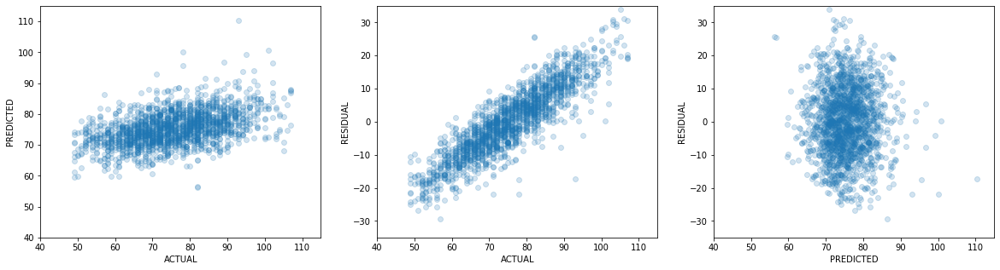

In [23]:
ncaa.plot_results(results, 'home')

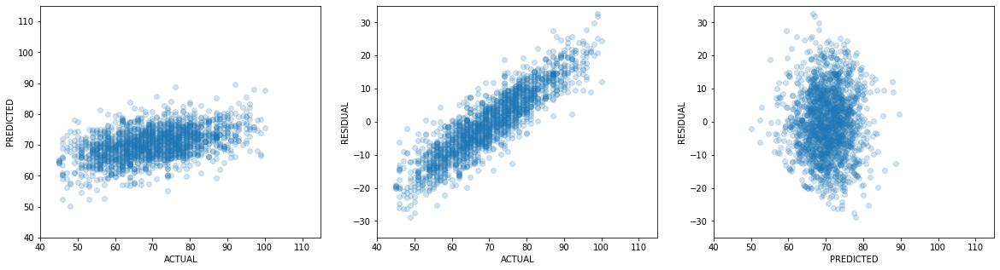

In [24]:
ncaa.plot_results(results, 'away')

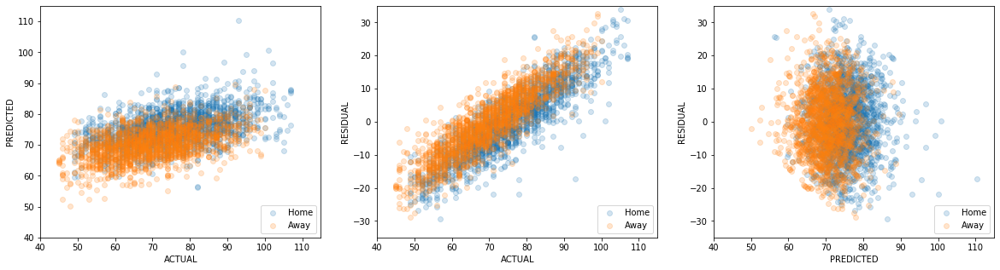

In [25]:
ncaa.plot_results(results, 'both')

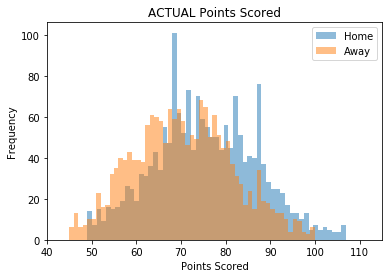

In [26]:
plt.title('ACTUAL Points Scored')
plt.xlabel('Points Scored')
plt.ylabel('Frequency')
plt.xlim([40, 115])
plt.hist(results.actual_home, bins = 55, alpha = .5)
plt.hist(results.actual_away, bins = 55, alpha = .5);
plt.legend(('Home', 'Away'));

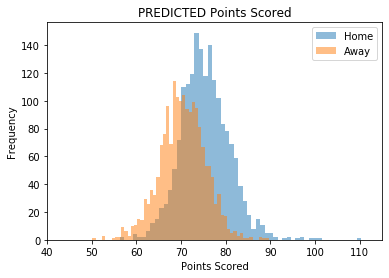

In [27]:
plt.title('PREDICTED Points Scored')
plt.xlabel('Points Scored')
plt.ylabel('Frequency')
plt.xlim([40, 115])
plt.hist(results.predicted_home, bins = 55, alpha = .5)
plt.hist(results.predicted_away, bins = 55, alpha = .5);
plt.legend(('Home', 'Away'));

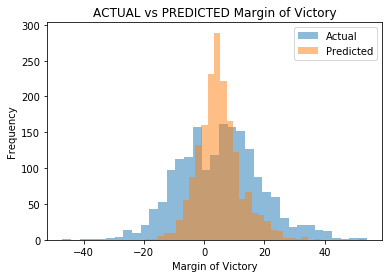

In [28]:
plt.title('ACTUAL vs PREDICTED Margin of Victory')
plt.xlabel('Margin of Victory')
plt.ylabel('Frequency')
plt.hist(results.actual_margin,    bins = 35, alpha = .5)
plt.hist(results.predicted_margin, bins = 35, alpha = .5);
plt.legend(('Actual', 'Predicted'));

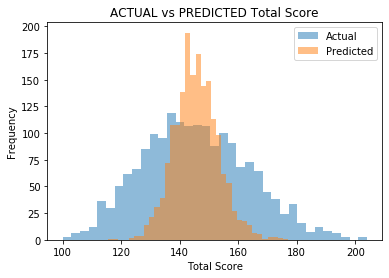

In [29]:
plt.title('ACTUAL vs PREDICTED Total Score')
plt.xlabel('Total Score')
plt.ylabel('Frequency')
plt.hist(results.actual_home + results.actual_away,       bins = 35, alpha = .5)
plt.hist(results.predicted_home + results.predicted_away, bins = 35, alpha = .5);
plt.legend(('Actual', 'Predicted'));

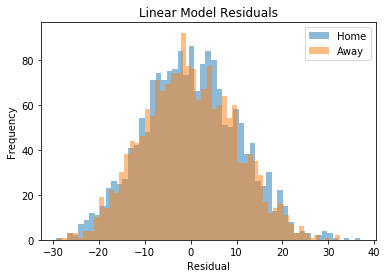

In [30]:
plt.title('Linear Model Residuals')
plt.xlabel('Residual')
plt.ylabel('Frequency')
plt.hist(results.residual_home, bins = 55, alpha = .5)
plt.hist(results.residual_away, bins = 55, alpha = .5);
plt.legend(('Home', 'Away'));

# Conclusions

As we see from the visualizations above, the two models (depite the unfavorable performance metrics) were in fact successful in predicting distinct distributions in the response variables (home and away scores). Both models did well in identifying the mean of their respective score distributions, but failed to accurately capture the variance in those distributions - which is consistent with the low observed R^2 scores. 

Importantly, however, this is not sufficient for our stated objective.  Even if the two models were to reasonably predict their respective response variables somewhat reliably, we would still likely fail to predict any of the three desired outcomes (winner, margin, total score) since doing so would require **both** models to be far more accurate/reliable under the same circumstances. 

Ultimately, the objective was likely too ambitious for the tools applied and additional techniques or better execution (see below) would likely prove more effective.

# Future Work

Having failed to consider the additional accuracy required from each model in order to predict a game's ultimate outcome, it's worth reconsidering the original design based on training a single model where the target variable is margin of victory. 

Unfortunately, the strategy of relying on many features and polynomial terms to capture the information required to accurately predict scores was not effective. In subsequent attenmpts, I will consider a more deliberate **"bottom-up** approach that aims to engineer more targeted, sophisticated features that more directly describe what what contributes to scoring. For example, 
 * Offensive Rebound % = Offensive Rebounds / (Offensive Rebounds + Opponent Defensive Rebounds)
 * Free Throw Rate = Free Throw Attempts / Field Goal Attempts

Naturally, the objective was rather ambitious and it's possible (if not likely) that OLS is an inadequate tool for the stated goal. Additional work may benefit from considering more robust/appropriate models such as weighted least squares (WLS), general linear models (GLM), or others. 

It's also likely future work would benefit from using more data, to combat the high level of bias observed in the analysis above, or the use of K-folds cross validation. 

Finally, the analysis above was done without regard to any categorical variables, such as team conference, an indicator identifying whether the game was played in-conference. The inclusion of such information may have also improved the models' performance. 

